In [1]:
import itertools
import numpy as np
import os
import seaborn as sns
from tqdm import tqdm
from dataclasses import asdict, dataclass, field
import vsketch
import shapely.geometry as sg
from shapely.geometry import box, MultiLineString, Point, MultiPoint, Polygon, MultiPolygon, LineString
import shapely.affinity as sa
import shapely.ops as so
import matplotlib.pyplot as plt
import pandas as pd

import vpype_cli
from typing import List, Generic
from genpen import genpen as gp, utils as utils
from scipy import stats as ss
import geopandas
from shapely.errors import TopologicalError
import functools
%load_ext autoreload
%autoreload 2

# Try 1

In [ ]:
page_x_inches: float = 17. # inches
page_y_inches: float = 11 # inches
border:float = 20.

buffer_style = 2

In [ ]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [ ]:
all_circles = []
circle_to_fill = drawbox
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.45, 0.08)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 20)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 1
iter_max = 10
rad_mults = (0.7, 0.06)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
bottom_circles = MultiPolygon([c for c in all_circles if not getattr(c, 'filled', False)])
bottom_circles

In [ ]:
all_circles = []
circle_to_fill = drawbox
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.15, 0.08)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 10)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 1
iter_max = 5
rad_mults = (0.25, 0.25)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
tri_vertices = MultiPoint([c.centroid for c in all_circles if not getattr(c, 'filled', False)])

In [ ]:
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

In [ ]:
length_filters = np.random.uniform(96, 185, size=len(trils))
tri_buffer = 2.3
ftrils = MultiLineString([l for l, lf in zip(trils, length_filters) if l.length<lf])
tris = ftrils.buffer(tri_buffer, cap_style=2, join_style=3)
tris

In [ ]:
stp = gp.ScaleTransPrms(
    d_buffer=-0.3, 
    angles=-60,

)
tri_fill = gp.scale_trans(tris, **stp.prms)

In [ ]:
tri_layer = gp.merge_LineStrings([p.boundary for p in tri_fill])

In [ ]:
layer = tri_layer.intersection(bottom_circles)

In [ ]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
sk.stroke(1)
sk.geometry(layer)
sk.display(color_mode='none')

In [ ]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0108_waka_waka.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.3mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

# try 2

In [ ]:
page_x_inches: float = 17. # inches
page_y_inches: float = 11 # inches
border:float = 20.

buffer_style = 2

In [ ]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [ ]:
all_circles = []
circle_to_fill = drawbox
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.48, 0.05)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 30)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 1
iter_max = 10
rad_mults = (0.7, 0.05)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
bottom_circles = MultiPolygon([c for c in all_circles if not getattr(c, 'filled', False)])
bottom_circles

In [ ]:
all_circles = []
circle_to_fill = drawbox.buffer(10)
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.15, 0.08)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 10)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 5
iter_max = 15
rad_mults = (0.3, 0.2)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
tri_vertices = MultiPoint([c.centroid for c in all_circles if not getattr(c, 'filled', False)])

trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

length_filters = np.random.uniform(96, 185, size=len(trils))
ftrils = MultiLineString([l for l, lf in zip(trils, length_filters) if l.length<lf])
tris = [f.buffer(np.random.uniform(1, 2.5), cap_style=2, join_style=3) for f in ftrils]
tris = gp.Poly(so.unary_union(tris))

stp = gp.ScaleTransPrms(
    d_buffer=-0.25, 
    angles=-60,

)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)
tris.fill_scale_trans(**stp.prms)
tri_lattice1 = tris

In [ ]:
all_circles = []
circle_to_fill = drawbox.buffer(10)
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.15, 0.08)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 10)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 5
iter_max = 25
rad_mults = (0.18, 0.18)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
tri_vertices = MultiPoint([c.centroid for c in all_circles if not getattr(c, 'filled', False)])

trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

length_filters = np.random.uniform(96, 185, size=len(trils))
ftrils = MultiLineString([l for l, lf in zip(trils, length_filters) if l.length<lf])
tris = [f.buffer(np.random.uniform(1, 2.2), cap_style=2, join_style=3) for f in ftrils]
tris = gp.Poly(so.unary_union(tris))

stp = gp.ScaleTransPrms(
    d_buffer=-0.35, 
    angles=-60,

)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)
tris.fill_scale_trans(**stp.prms)
tri_lattice2 = tris

In [ ]:
layer1 = tri_lattice1.fill.intersection(bottom_circles)
layer2 = tri_lattice2.fill.difference(tri_lattice1.p).intersection(bottom_circles)

In [ ]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
sk.stroke(1)
sk.geometry(layer1)
sk.stroke(2)
sk.geometry(layer2)
sk.display(color_mode='layer')

In [ ]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0118_waka_waka.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.1mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

# try 3

In [ ]:
page_x_inches: float = 17. # inches
page_y_inches: float = 11 # inches
border:float = 20.

buffer_style = 2

In [ ]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [ ]:
all_circles = []
circle_to_fill = drawbox
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.48, 0.05)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 30)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 2
iter_max = 50
rad_mults = (0.7, 0.05)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
bottom_circles = MultiPolygon([c for c in all_circles if not getattr(c, 'filled', False)])
bottom_circles

In [ ]:
all_circles = []
circle_to_fill = drawbox.buffer(10)
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.15, 0.08)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 10)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 5
iter_max = 15
rad_mults = (0.3, 0.2)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
tri_vertices = MultiPoint([c.centroid for c in all_circles if not getattr(c, 'filled', False)])

trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

length_filters = np.random.uniform(96, 185, size=len(trils))
ftrils = MultiLineString([l for l, lf in zip(trils, length_filters) if l.length<lf])
tris = [f.buffer(np.random.uniform(1.2, 3), cap_style=2, join_style=3) for f in ftrils]
tris = gp.Poly(so.unary_union(tris))

stp = gp.ScaleTransPrms(
    d_buffer=-0.22, 
    angles=-60,

)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)
tris.fill_scale_trans(**stp.prms)
tri_lattice1 = tris

In [ ]:
all_circles = []
circle_to_fill = drawbox.buffer(10)
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.15, 0.08)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 10)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 5
iter_max = 15
rad_mults = (0.18, 0.18)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
tri_vertices = MultiPoint([c.centroid for c in all_circles if not getattr(c, 'filled', False)])

trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

length_filters = np.random.uniform(96, 185, size=len(trils))
ftrils = MultiLineString([l for l, lf in zip(trils, length_filters) if l.length<lf])
tris = [f.buffer(np.random.uniform(1, 2.5), cap_style=2, join_style=3) for f in ftrils]
tris = gp.Poly(so.unary_union(tris))

stp = gp.ScaleTransPrms(
    d_buffer=-0.25, 
    angles=-60,

)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)
tris.fill_scale_trans(**stp.prms)
tri_lattice2 = tris

In [ ]:
all_circles = []
circle_to_fill = drawbox.buffer(10)
# init
fc_rad = gp.get_rad(circle_to_fill)
x = circle_to_fill.centroid.x
rad_mults = (0.15, 0.08)
rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 10)
circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
all_circles += list(circles)
circle_to_fill.filled = True
not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
areas = np.array([c.area for c in not_yet_filled])
areas = areas/areas.sum()
circle_to_fill = np.random.choice(not_yet_filled, p=areas)
circles

In [ ]:
min_rad = 5
iter_max = 20
rad_mults = (0.18, 0.18)

In [ ]:
n_fails = 0
n_iters = 0
pbar = tqdm(total=iter_max)
while (n_fails < 20) and (n_iters < iter_max):
    try:
#         pbar.update()
        n_iters += 1
        fc_rad = gp.get_rad(circle_to_fill)
        
        rads = np.linspace(fc_rad*rad_mults[0], fc_rad*rad_mults[1], 80)
        rads[rads<min_rad] = min_rad
        circles = gp.circle_pack_within_poly(circle_to_fill, rads, progress_bar=False)
        circle_to_fill.filled = True
        all_circles += list(circles)
        not_yet_filled = [c for c in all_circles if not getattr(c, 'filled', False)]
        areas = np.array([c.area for c in not_yet_filled])
        areas = areas/areas.sum()
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        n_fails = 0
    except:
        n_fails += 1
        circle_to_fill = np.random.choice(not_yet_filled, p=areas)
        
print(f'total iters = {n_iters}')
print(f'total fails = {n_fails}')
MultiPolygon(all_circles).boundary

In [ ]:
tri_vertices = MultiPoint([c.centroid for c in all_circles if not getattr(c, 'filled', False)])

trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

length_filters = np.random.uniform(96, 185, size=len(trils))
ftrils = MultiLineString([l for l, lf in zip(trils, length_filters) if l.length<lf])
tris = [f.buffer(np.random.uniform(0.8, 1.8), cap_style=2, join_style=3) for f in ftrils]
tris = gp.Poly(so.unary_union(tris))

stp = gp.ScaleTransPrms(
    d_buffer=-0.35, 
    angles=-60,

)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)
tris.fill_scale_trans(**stp.prms)
tri_lattice3 = tris

In [ ]:
layer1 = tri_lattice1.fill.intersection(bottom_circles)
layer2 = tri_lattice2.fill.difference(tri_lattice1.p).intersection(bottom_circles)
layer3 = tri_lattice3.fill.difference(tri_lattice1.p).difference(tri_lattice2.p).intersection(bottom_circles)

In [ ]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
sk.stroke(1)
sk.geometry(layer1)
sk.stroke(2)
sk.geometry(layer2)
sk.stroke(3)
sk.geometry(layer3)
sk.display(color_mode='layer')

In [ ]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0119_waka_waka.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.25mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

# Try 4

In [ ]:
page_x_inches: float = 17. # inches
page_y_inches: float = 11 # inches
border:float = 20.

buffer_style = 2

In [ ]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [ ]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.48,
    rad_seq_end=0.05,
    min_allowed_rad=2,
    n_rads=30,
)
rcp.run(1)

In [ ]:
rcp.rad_seq_start=0.6
rcp.rad_seq_end=0.04
rcp.n_rads=80
rcp.run(50, progress_bar=True)
rcp.unfilled_circles

## lattice 1

In [ ]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(2.1, 2.8).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [ ]:
occluded_tris = tris.intersection(rcp.unfilled_circles).buffer(-1e-6)

In [ ]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [ ]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [ ]:
layer1 = gp.merge_LineStrings(fills)

In [ ]:
all_polys = occluded_tris

## lattice 2

In [ ]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.4, 2.2).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [ ]:
int_tris = tris.intersection(rcp.unfilled_circles)

In [ ]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [ ]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [ ]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [ ]:
layer2 = gp.merge_LineStrings(fills)

In [ ]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(-1e-6)

## lattice3

In [ ]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(4)

In [ ]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.5, 1.8).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [ ]:
int_tris = tris.intersection(rcp.unfilled_circles)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [ ]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [ ]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [ ]:
layer3 = gp.merge_LineStrings(fills)

In [ ]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [ ]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
sk.stroke(1)
sk.geometry(layer1)
sk.stroke(2)
sk.geometry(layer2)
sk.stroke(3)
sk.geometry(layer3)
sk.display(color_mode='none')

In [ ]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0120_waka_waka.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.1mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

# Try 5

In [ ]:
page_x_inches: float = 17. # inches
page_y_inches: float = 11 # inches
border:float = 20.

buffer_style = 2

In [ ]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [ ]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.48,
    rad_seq_end=0.05,
    min_allowed_rad=2,
    n_rads=30,
)
rcp.run(1)

In [ ]:
rcp.rad_seq_start=0.7
rcp.rad_seq_end=0.09
rcp.n_rads=80
rcp.run(10, progress_bar=True)
rcp.unfilled_circles

## lattice 1

In [ ]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.12,
    rad_seq_end=0.12, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

In [ ]:

def map_on_xrange(ls, xp, fp, *args, **kwargs):
    return np.interp(ls.centroid.x, xp=xp, fp=fp)
xp = [drawbox.bounds[0], drawbox.bounds[2]]

In [ ]:
vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])

In [ ]:
DL = gp.DelauneyLattice(
    vertices=vertices,
    max_length_filter_gen=lambda *args: ss.uniform(96, 185).rvs(),
    min_length_filter_gen=gp.make_callable(0),
    buffer_size_gen=functools.partial(map_on_xrange, xp=xp, fp=[0.8, 2.5]),
    buffer_individually=True,
)

In [ ]:
occluded_tris = so.unary_union(DL.polys).intersection(rcp.unfilled_circles).buffer(1e-6)

In [ ]:
stp = gp.ScaleTransPrms(d_buffer=-0.35,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [ ]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [ ]:
layer1 = gp.merge_LineStrings(fills)

In [ ]:
all_polys = occluded_tris

## lattice 2

In [ ]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.10,
    rad_seq_end=0.10, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)


In [ ]:
vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])

In [ ]:
DL = gp.DelauneyLattice(
    vertices=vertices,
    max_length_filter_gen=lambda *args: ss.uniform(96, 185).rvs(),
    min_length_filter_gen=gp.make_callable(0),
    buffer_size_gen=functools.partial(map_on_xrange, xp=xp, fp=[2.5, 0.8]),
    buffer_individually=True,
)

In [ ]:
int_tris = so.unary_union(DL.polys).intersection(rcp.unfilled_circles).buffer(-1e-6)

In [ ]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=1e-6)

In [ ]:
stp = gp.ScaleTransPrms(d_buffer=-0.35,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [ ]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [ ]:
layer2 = gp.merge_LineStrings(fills)

In [ ]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(1e-6)

In [ ]:
all_polys

## lattice3

In [ ]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)


In [ ]:
vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])

In [ ]:
DL = DelauneyLattice(
    vertices=vertices,
    max_length_filter_gen=lambda *args: ss.uniform(96, 185).rvs(),
    min_length_filter_gen=gp.make_callable(0),
    buffer_size_gen=functools.partial(map_on_xrange, xp=xp, fp=[0.5, 2]),
    buffer_individually=True,
)

In [ ]:
int_tris = so.unary_union(DL.polys).intersection(rcp.unfilled_circles).buffer(1e-6)

In [ ]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=1e-6)

In [ ]:
stp = gp.ScaleTransPrms(d_buffer=-0.35,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [ ]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [ ]:
layer3 = gp.merge_LineStrings(fills)

In [ ]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(1e-6)

In [ ]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
sk.stroke(1)
sk.geometry(layer1)
sk.stroke(2)
sk.geometry(layer2)
sk.stroke(3)
sk.geometry(layer3)
sk.display(color_mode='none')

In [ ]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0120_waka_waka.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.1mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

# Try 6

In [2]:
page_x_inches: float = 17. # inches
page_y_inches: float = 11 # inches
border:float = 20.

buffer_style = 2

In [3]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [4]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.5,
    rad_seq_end=0.1,
    min_allowed_rad=2,
    n_rads=90,
)
rcp.run(1)

100%|██████████| 3/3 [00:01<00:00,  2.47it/s]

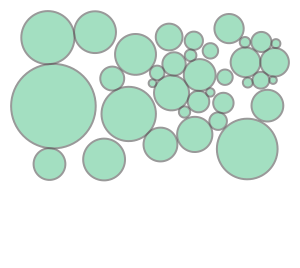

In [5]:
rcp.rad_seq_start=0.5
rcp.rad_seq_end=0.1
rcp.n_rads=80
rcp.run(3, progress_bar=True)
rcp.unfilled_circles

In [6]:
# init
rcp2 = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.4,
    rad_seq_end=0.1,
    min_allowed_rad=2,
    n_rads=90,
)
rcp2.run(1)


100%|██████████| 3/3 [00:02<00:00,  1.49it/s]

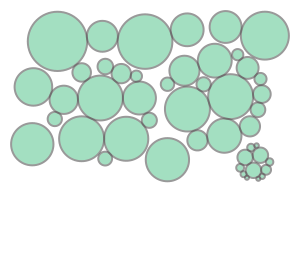

In [7]:
rcp2.rad_seq_start=0.4
rcp2.rad_seq_end=0.1
rcp2.n_rads=80
rcp2.run(3, progress_bar=True)
rcp2.unfilled_circles

In [8]:
# init
rcp3 = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.4,
    rad_seq_end=0.1,
    min_allowed_rad=2,
    n_rads=90,
)
rcp3.run(1)

100%|██████████| 5/5 [00:03<00:00,  1.46it/s]

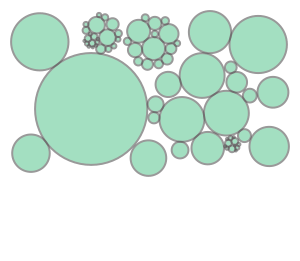

In [9]:
rcp3.rad_seq_start=0.4
rcp3.rad_seq_end=0.1
rcp3.n_rads=80
rcp3.run(5, progress_bar=True)
rcp3.unfilled_circles

In [15]:
d1 = rcp.unfilled_circles.intersection(rcp2.unfilled_circles).buffer(4, cap_style=2).difference(rcp3.unfilled_boundary.buffer(3))

In [61]:
stp = gp.ScaleTransPrms(d_buffer=-1.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.15, 0.15, size=stp.d_buffers.shape)
stp.angles = np.linspace(np.radians(720), 0,  stp.d_buffers.shape[0])
fills = []
for p in d1:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

layer1 = gp.merge_LineStrings(fills)

In [62]:
morse_lss = []
for ls in tqdm(layer1):
    morsed = ls.buffer(1e-7).buffer(-1e-7).boundary
    morse_lss.append(morsed)

100%|██████████| 567/567 [00:03<00:00, 171.04it/s]


In [63]:
filt_lss = [ls for ls in morse_lss if ls.length > 0.1]

In [64]:
layer2 = gp.merge_LineStrings(filt_lss)

In [65]:
layer3 = gp.merge_LineStrings([ls for ls in layer2 if ls.length > 0.5])

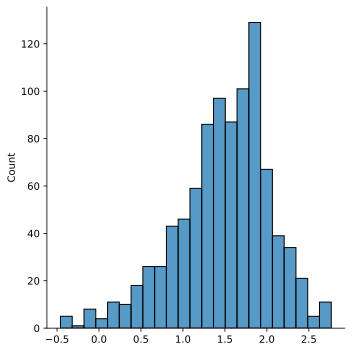

In [44]:
sns.displot([np.log10(ls.length) for ls in filt_lss])

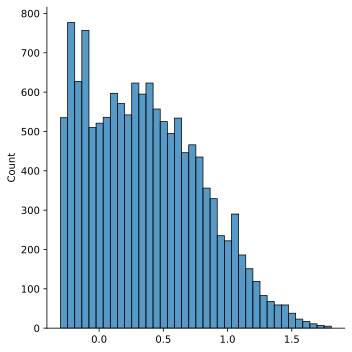

In [52]:
sns.displot([np.log10(ls.length) for ls in layer3])

In [66]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
# sk.stroke(1)
# sk.geometry(layer1)
sk.stroke(2)
sk.geometry(layer3)
sk.display(color_mode='none')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2020-12-17T22:29:07.022252 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="279.7506,655.0046 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495 280.8789,656.2495"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="253.4531,633.3833 253.4531,633.3833 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 265.3585,649.4359 253.4531,633.3833"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="246.5183,637.5534 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237 251.6137,644.4237"/>
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="168.4909,482.3938 177.2371,480.203 177.2371,480.203 178.0069,480.0499 178.0069,480.0499 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 183.4968,479.2355 178.0069,480.0499 178.0069,480.0499 177.2371,480.203 177.2371,480.203 168.4909,482.3938 168.4909,482.3938"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="222.5757,633.9993 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 212.4676,636.9675 212.4676,636.9675 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003 224.0148,636.4003"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 208.3792,633.9809 208.3792,633.9809 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223 211.6085,633.8223"/>
 
 
 
 
 
 
 
 
 
 
 <polygon points="199.1999,631.4099 199.5327,631.9651 199.5327,631.9651 199.5327,631.9651 199.5327,631.9651 199.5327,631.9651 199.5327,631.9651 199.5327,631.9651


  0%|          | 0/85 [00:00<?, ?it/s]

In [78]:
from time import sleep

In [79]:
pbar = tqdm(total = 76)
for i in range(31):
    sleep(0.1)
    pbar.update()




  0%|          | 0/76 [00:00<?, ?it/s]


  1%|▏         | 1/76 [00:00<00:07,  9.96it/s]


  3%|▎         | 2/76 [00:00<00:07,  9.93it/s]


  4%|▍         | 3/76 [00:00<00:07,  9.89it/s]


  5%|▌         | 4/76 [00:00<00:07,  9.84it/s]


  7%|▋         | 5/76 [00:00<00:07,  9.84it/s]


  8%|▊         | 6/76 [00:00<00:07,  9.80it/s]


  9%|▉         | 7/76 [00:00<00:07,  9.79it/s]


 11%|█         | 8/76 [00:00<00:06,  9.79it/s]


 12%|█▏        | 9/76 [00:00<00:06,  9.77it/s]


 13%|█▎        | 10/76 [00:01<00:06,  9.79it/s]


 14%|█▍        | 11/76 [00:01<00:06,  9.80it/s]


 16%|█▌        | 12/76 [00:01<00:06,  9.82it/s]


 17%|█▋        | 13/76 [00:01<00:06,  9.82it/s]


 18%|█▊        | 14/76 [00:01<00:06,  9.82it/s]


 20%|█▉        | 15/76 [00:01<00:06,  9.80it/s]


 21%|██        | 16/76 [00:01<00:06,  9.80it/s]


 22%|██▏       | 17/76 [00:01<00:06,  9.81it/s]


 24%|██▎       | 18/76 [00:01<00:05,  9.82it/s]


 25%|██▌       | 19/76 [00:01<00:05,  9.82it/s]


 26%|██▋       

In [83]:
5.256e5

525600.0

In [84]:
1/525600.

1.902587519025875e-06

In [85]:
spy = 1/(525600 * 60)


In [88]:
import pandas as pd

In [105]:
td = pd.to_timedelta(secs_remaining, unit='S')

In [118]:
td += pd.to_timedelta(127, unit='m')

In [146]:
from string import Template

class DeltaTemplate(Template):
    delimiter = "%"

def strfdelta(tdelta, fmt):
    
    days = tdelta.days
    d = {}
    d['Y'], rem = divmod(days, 365)
    d['D'] = rem
    
    hours, rem = divmod(tdelta.seconds, 3600)
    minutes, seconds = divmod(rem, 60)
    
    d["H"] = '{:02d}'.format(hours)
    d["M"] = '{:02d}'.format(minutes)
    d["S"] = '{:02d}'.format(seconds)
    t = DeltaTemplate(fmt)
    return t.substitute(**d)

In [148]:
strfdelta(td,'%Y:%H:%M:%S')

'45 d 02:07:00'

In [107]:
td.isoformat()

'P16425DT0H0M0S'

In [166]:
sr = pd.to_timedelta(secs_remaining, unit='S')
strfdelta(sr,'%Y:%D:%H:%M:%S')

'45:9:07:32:56'

In [168]:
def iso8601(tdelta):
    ts = tdelta.total_seconds()
    d = int(ts // 86400)
    s = round(ts % 60, 6)
    hms = int(ts // 3600 % 24), int(ts // 60 % 60), s if s % 1 != 0 else int(s)
    t = ''.join([str(p[0]) + p[1] for p in zip(hms, ['H', 'M', 'S']) if p[0]])
    sep = 'T' if any(hms) else ''
    return 'P' + (str(d) + 'D' if d else '') + sep + (t if ts else 'T0S')

In [169]:
iso8601(sr)

'P16434DT7H32M56S'

In [167]:
se = pd.to_timedelta(secs_elapsed, unit='S')
strfdelta(se,'%Y:%D:%H:%M:%S')

'31:0:02:07:03'

In [155]:
secs_elapsed = 31 * spy**-1 + 7623

In [156]:
secs_elapsed

977623623.0

In [160]:
total_secs = (76 * spy**-1) + 812399

In [161]:
total_secs

2397548399.0

In [162]:
secs_remaining = total_secs - secs_elapsed

In [163]:
secs_remaining

1419924776.0

In [67]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0121_morsed_circle_pack_diffs.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.2mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

0

# Try 6

In [2]:
page_x_inches: float = 14. # inches
page_y_inches: float = 11 # inches
border:float = 30.

buffer_style = 2

In [3]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [4]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.48,
    rad_seq_end=0.05,
    min_allowed_rad=2,
    n_rads=30,
)
rcp.run(1)

In [5]:
rcp.rad_seq_start=0.6
rcp.rad_seq_end=0.04
rcp.n_rads=80
rcp.run(50, progress_bar=True)
rcp.unfilled_circles

100%|██████████| 50/50 [01:19<00:00,  1.56s/it]

## lattice 1

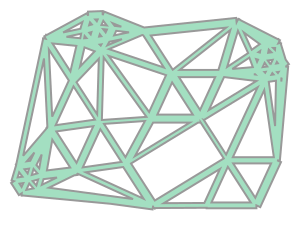

In [6]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(2.1, 2.8).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [7]:
occluded_tris = tris.intersection(rcp.unfilled_circles).buffer(-1e-6)

In [8]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [9]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [10]:
layer1 = gp.merge_LineStrings(fills)

In [11]:
all_polys = occluded_tris

## lattice 2

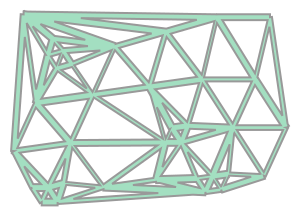

In [12]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.4, 2.2).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [13]:
int_tris = tris.intersection(rcp.unfilled_circles)

In [14]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [15]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [16]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [17]:
layer2 = gp.merge_LineStrings(fills)

In [18]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(-1e-6)

## lattice3

In [19]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(4)

In [20]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.5, 1.8).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [21]:
int_tris = tris.intersection(rcp.unfilled_circles)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [22]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [23]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [24]:
layer3 = gp.merge_LineStrings(fills)

100%|██████████| 50/50 [03:11<00:00,  3.83s/it]


In [25]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [27]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
sk.stroke(1)
sk.geometry(layer1)
sk.stroke(2)
sk.geometry(layer2)
sk.stroke(3)
sk.geometry(layer3)
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-02-20T17:29:09.930915 
 
 
 
 
 
 <polygon points="1215.8735,632.0966 1215.2875,625.4172 1215.1135,625.2881 1214.7361,625.0619 1214.3384,624.8738 1213.9242,624.7256 1213.4974,624.6187 1213.0623,624.5542 1212.6228,624.5326 1212.1834,624.5542 1211.7482,624.6187 1211.3215,624.7256 1210.9073,624.8738 1210.5095,625.0619 1210.1322,625.2881 1209.7788,625.5502 1209.4528,625.8456 1209.1574,626.1716 1208.8953,626.525 1208.6691,626.9023 1208.481,627.3 1208.3328,627.7143 1208.2259,628.141 1208.1614,628.5762 1208.1398,629.0156 1208.1614,629.455 1208.2259,629.8902 1208.3328,630.317 1208.481,630.7312 1208.6691,631.1289 1208.8953,631.5063 1209.1574,631.8596 1209.4528,632.1856 1209.7788,632.4811 1210.1322,632.7431 1210.5095,632.9693 1210.9073,633.1574 1211.3215,633.3056 1211.7482,633.4125 1212.1834,633.4771 1212.6228,633.4987 1213.0623,633.4771 1213.4974,633.4125 1213.9242,633.3056 1214.3384,633.1574 1214.7361,632.9693 1215.1135,632.7431 1215.4669,632.4811 1215.7928,632.1856"/>
 <polygon points="1214.0133,626.631 1213.8801,626.5512 1213.5594,626.3996 1213.2254,626.2801 1212.8813,626.1939 1212.5304,626.1418 1212.1761,626.1244 1211.8218,626.1418 1211.4709,626.1939 1211.1268,626.2801 1210.7928,626.3996 1210.4721,626.5512 1210.1678,626.7336 1209.8829,626.9449 1209.62,627.1832 1209.3818,627.446 1209.1705,627.7309 1208.9881,628.0352 1208.8365,628.3559 1208.7169,628.6899 1208.6307,629.034 1208.5787,629.3849 1208.5613,629.7392 1208.5787,630.0935 1208.6307,630.4444 1208.7169,630.7886 1208.8365,631.1226 1208.9881,631.4432 1209.1705,631.7475 1209.3818,632.0324 1209.62,632.2953 1209.8829,632.5335 1210.1678,632.7448 1210.4721,632.9272 1210.7928,633.0789 1211.1268,633.1984 1211.4709,633.2846 1211.8218,633.3366 1212.1761,633.3541 1212.5304,633.3366 1212.8813,633.2846 1213.2254,633.1984 1213.5594,633.0789 1213.8801,632.9272 1214.1844,632.7448 1214.4693,632.5335 1214.5266,632.4816"/>
 <polygon points="1212.7174,627.9339 1212.5181,627.8626 1212.2595,627.7978 1211.9957,627.7587 1211.7294,627.7456 1211.4631,627.7587 1211.1993,627.7978 1210.9406,627.8626 1210.6896,627.9525 1210.4485,628.0665 1210.2198,628.2036 1210.0056,628.3624 1209.808,628.5415 1209.629,628.7391 1209.4701,628.9532 1209.333,629.1819 1209.219,629.423 1209.1292,629.6741 1209.0644,629.9327 1209.0253,630.1965 1209.0122,630.4628 1209.0253,630.7292 1209.0644,630.9929 1209.1292,631.2516 1209.219,631.5027 1209.333,631.7437 1209.4701,631.9724 1209.629,632.1866 1209.808,632.3842 1210.0056,632.5633 1210.2198,632.7221 1210.4485,632.8592 1210.6896,632.9732 1210.9406,633.063 1211.1993,633.1278 1211.4631,633.167 1211.7294,633.18 1211.9957,633.167 1212.2595,633.1278 1212.5181,633.063 1212.7692,632.9732 1213.0103,632.8592 1213.1425,632.7799"/>
 <polygon points="1211.3433,629.4681 1211.2827,629.4651 1211.1139,629.4734 1210.9468,629.4982 1210.783,629.5392 1210.6239,629.5961 1210.4712,629.6683 1210.3263,629.7552 1210.1906,629.8558 1210.0655,629.9693 1209.952,630.0944 1209.8514,630.2301 1209.7646,630.375 1209.6923,630.5277 1209.6354,630.6868 1209.5944,630.8506 1209.5696,631.0177 1209.5613,631.1864 1209.5696,631.3552 1209.5944,631.5223 1209.6354,631.6861 1209.6923,631.8452 1209.7646,631.9979 1209.8514,632.1428 1209.952,632.2784 1210.0655,632.4036 1210.1906,632.5171 1210.3263,632.6177 1210.4712,632.7045 1210.6239,632.7767 1210.783,632.8337 1210.9468,632.8747 1211.1139,632.8995 1211.2827,632.9078 1211.4514,632.8995 1211.6185,632.8747 1211.6417,632.8689"/>
 <polygon points="1215.1963,624.3778 1214.383,615.1072 1214.3657,615.1098 1213.9201,615.2214 1213.4876,615.3761 1213.0723,615.5725 1212.6783,615.8087 1212.3093,616.0824 1211.9689,616.3909 1211.6604,616.7312 1211.3868,617.1002 1211.1506,617.4942 1210.9542,617.9095 1210.7994,618.342 1210.6878,618.7876 1210.6204,619.242 1210.5979,619.7009 1210.6204,620.1597 1210.6878,620.6141 1210.7994,621.0597 1210.9542,621.4922 1211.1506,621.9075 1211.3868,622.3015 1211.6604,622.6705 1211.9689,623.0108 1212.3093,623

In [28]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0274_cpack_beams.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.1mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

0

# Try 7

In [2]:
page_x_inches: float = 7. # inches
page_y_inches: float = 5 # inches
border:float = 15.

buffer_style = 2

In [3]:
px = utils.DistanceConverter(page_x_inches, 'inches').mm
py = utils.DistanceConverter(page_y_inches, 'inches').mm
page_format = f'{px}mmx{py}mm'
drawbox = sg.box(border, border, px-border, py-border)

xmin, ymin, xmax, ymax = drawbox.bounds


In [4]:
# init
rcp = gp.RecursiveCirclePacker(
    drawbox, 
    rad_seq_start=0.48,
    rad_seq_end=0.05,
    min_allowed_rad=2,
    n_rads=30,
)
rcp.run(1)

In [5]:
rcp.rad_seq_start=0.6
rcp.rad_seq_end=0.04
rcp.n_rads=80
rcp.run(50, progress_bar=True)
rcp.unfilled_circles

100%|██████████| 50/50 [01:22<00:00,  1.52s/it]

## lattice 1

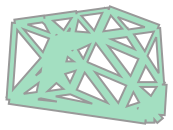

In [6]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.29
trcp.rad_seq_end=0.18
trcp.run(3)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(2.1, 2.8).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [7]:
occluded_tris = tris.intersection(rcp.unfilled_circles).buffer(-1e-6)

In [8]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [9]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [10]:
layer1 = gp.merge_LineStrings(fills)

In [11]:
all_polys = occluded_tris

## lattice 2

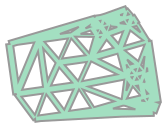

In [12]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(20), rad_seq_start=0.16,
    rad_seq_end=0.16, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.3
trcp.rad_seq_end=0.3
trcp.run(4)

length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.4, 2.2).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)
tris

In [13]:
int_tris = tris.intersection(rcp.unfilled_circles)

In [14]:
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [15]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [16]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [17]:
layer2 = gp.merge_LineStrings(fills)

In [18]:
all_polys = so.unary_union([all_polys, occluded_tris]).buffer(-1e-6)

## lattice3

In [19]:
trcp = gp.RecursiveCirclePacker(drawbox.buffer(10), rad_seq_start=0.15,
    rad_seq_end=0.15, min_allowed_rad=2, n_rads=10, )
trcp.run(1)
trcp.min_allowed_rad=5
trcp.rad_seq_start=0.2
trcp.rad_seq_end=0.2
trcp.run(4)

In [20]:
length_filter_gen = ss.uniform(96, 185).rvs
buffer_size_gen = ss.uniform(1.5, 1.8).rvs
tri_vertices = MultiPoint([c.centroid for c in trcp.unfilled_circles])
trils = MultiLineString(so.triangulate(tri_vertices, edges=True))

filt_trils = MultiLineString([l for l in trils if l.length<length_filter_gen()])
tris = [f.buffer(buffer_size_gen(), cap_style=2, join_style=3) for f in filt_trils]
tris = so.unary_union(tris)

In [21]:
int_tris = tris.intersection(rcp.unfilled_circles)
occluded_tris = gp.robust_difference(int_tris, all_polys, buffer_distance=-1e-6)

In [22]:
stp = gp.ScaleTransPrms(d_buffer=-0.25,angles=-45,)
stp.d_buffers += np.random.uniform(-0.03, 0.03, size=stp.d_buffers.shape)

In [23]:
fills = []
for p in occluded_tris:
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    fills.append(P.fill)

In [24]:
layer3 = gp.merge_LineStrings(fills)

100%|██████████| 50/50 [01:49<00:00,  2.19s/it]


In [25]:
all_polys = gp.merge_Polygons([all_polys, occluded_tris])

In [26]:
sk = vsketch.Vsketch()
sk.size(page_format)

sk.scale('1mm')
sk.stroke(1)
sk.geometry(layer1)
sk.stroke(2)
sk.geometry(layer2)
sk.stroke(3)
sk.geometry(layer3)
sk.display(color_mode='layer')

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-02-26T23:21:33.208490 
 
 
 
 
 
 <polygon points="612.1456,355.5317 612.1324,355.2634 612.093,354.9978 612.0278,354.7373 611.9373,354.4844 611.8225,354.2417 611.6844,354.0113 611.5244,353.7956 611.3441,353.5967 611.1451,353.4163 610.9294,353.2563 610.6991,353.1183 610.4563,353.0035 610.2035,352.913 609.943,352.8477 609.6773,352.8083 609.4091,352.7952 609.1409,352.8083 608.8752,352.8477 608.6147,352.913 608.3619,353.0035 608.1191,353.1183 607.8888,353.2563 607.6731,353.4163 607.4741,353.5967 607.2938,353.7956 607.1338,354.0113 606.9957,354.2417 606.8809,354.4844 606.7904,354.7373 606.7252,354.9978 606.6858,355.2634 606.6726,355.5317 606.6858,355.7999 606.7252,356.0655 606.7904,356.326 606.8809,356.5789 606.9957,356.8216 607.1338,357.052 607.2938,357.2677 607.4741,357.4667 607.6731,357.647 607.8888,357.807 608.1191,357.945 608.3619,358.0599 608.6147,358.1503 608.8752,358.2156 609.1409,358.255 609.4091,358.2682 609.6773,358.255 609.943,358.2156 610.2035,358.1503 610.4563,358.0599 610.6991,357.945 610.9294,357.807 611.1451,357.647 611.3441,357.4667 611.5244,357.2677 611.6844,357.052 611.8225,356.8216 611.9373,356.5789 612.0278,356.326 612.093,356.0655 612.1324,355.7999"/>
 <polygon points="610.8345,356.2553 610.8255,356.0718 610.7985,355.89 610.7539,355.7118 610.692,355.5388 610.6135,355.3727 610.519,355.2152 610.4096,355.0676 610.2862,354.9315 610.15,354.8081 610.0025,354.6986 609.8449,354.6042 609.6788,354.5256 609.5058,354.4637 609.3276,354.4191 609.1459,354.3921 608.9624,354.3831 608.7789,354.3921 608.5971,354.4191 608.4189,354.4637 608.2459,354.5256 608.0799,354.6042 607.9223,354.6986 607.7747,354.8081 607.6386,354.9315 607.5152,355.0676 607.4058,355.2152 607.3113,355.3727 607.2327,355.5388 607.1709,355.7118 607.1262,355.89 607.0993,356.0718 607.0902,356.2553 607.0993,356.4388 607.1262,356.6205 607.1709,356.7987 607.2327,356.9717 607.3113,357.1378 607.4058,357.2954 607.5152,357.4429 607.6386,357.5791 607.7747,357.7024 607.9223,357.8119 608.0799,357.9063 608.2459,357.9849 608.4189,358.0468 608.5971,358.0914 608.7789,358.1184 608.9624,358.1274 609.1459,358.1184 609.3276,358.0914 609.5058,358.0468 609.6788,357.9849 609.8449,357.9063 610.0025,357.8119 610.15,357.7024 610.2862,357.5791 610.4096,357.4429 610.519,357.2954 610.6135,357.1378 610.692,356.9717 610.7539,356.7987 610.7985,356.6205 610.8255,356.4388"/>
 <polygon points="609.351,356.9789 609.347,356.897 609.335,356.8159 609.315,356.7364 609.2874,356.6592 609.2524,356.5851 609.2102,356.5148 609.1614,356.4489 609.1063,356.3882 609.0456,356.3331 608.9798,356.2843 608.9094,356.2421 608.8353,356.2071 608.7581,356.1795 608.6786,356.1595 608.5975,356.1475 608.5156,356.1435 608.4338,356.1475 608.3527,356.1595 608.2731,356.1795 608.196,356.2071 608.1219,356.2421 608.0515,356.2843 607.9857,356.3331 607.9249,356.3882 607.8699,356.4489 607.8211,356.5148 607.7789,356.5851 607.7439,356.6592 607.7162,356.7364 607.6963,356.8159 607.6843,356.897 607.6803,356.9789 607.6843,357.0607 607.6963,357.1418 607.7162,357.2214 607.7439,357.2986 607.7789,357.3727 607.8211,357.443 607.8699,357.5088 607.9249,357.5696 607.9857,357.6246 608.0515,357.6735 608.1219,357.7156 608.196,357.7507 608.2731,357.7783 608.3527,357.7982 608.4338,357.8102 608.5156,357.8142 608.5975,357.8102 608.6786,357.7982 608.7581,357.7783 608.8353,357.7507 608.9094,357.7156 608.9798,357.6735 609.0456,357.6246 609.1063,357.5696 609.1614,357.5088 609.2102,357.443 609.2524,357.3727 609.2874,357.2986 609.315,357.2214 609.335,357.1418 609.347,357.0607"/>
 <polygon points="612.1053,358.037 612.1026,357.9822 612.0945,357.928 612.0812,357.8748 612.0628,357.8232 612.0393,357.7737 612.0111,357.7266 611.9785,357.6826 611.9417,357.642 611.901,357.6052 611.857,357.5725 611.81,357.5443 611.7604,357.5209 611.7088,357.5024 611.6556,357.4891 611.6014,357.4811 611.5467,357.4784 611.4919,357.4811 611.4377,357.4891 611.3845,357.5024 611.3329,357.5209 611.2833,357.5443 611.2363,357

In [27]:
savepath = '/mnt/c/code/side/plotter_images/oned_outputs/0278_cpack_beams.svg'

sk.save(savepath)

vpype_commands = 'reloop linesimplify --tolerance 0.1mm linemerge --tolerance 0.1mm linesort'
vpype_str = f'vpype read -q 0.05mm {savepath} {vpype_commands} write {savepath}'

os.system(vpype_str)

0